In [1]:
import numpy as np
import sympy as sym
import json
import matplotlib.pyplot as plt
from scipy import linalg
from scipy.interpolate import interp1d
import plotly.graph_objects as go
import pandas as pd
import plotly.express as px
from mpl_toolkits.mplot3d import Axes3D

In [2]:
def load_hardware_data(filename, t_min_offset=0, t_max_offset=0, only_in_flight=False):
    # load raw data
    with open(filename, 'r') as f:
        data = json.load(f)

    # convert lists to numpy arrays
    for val in data.values():
        for key in val.keys():
            val[key] = np.array(val[key])

    # create an array of times at which to subsample
    t_min = -np.inf
    t_max = np.inf
    for key, val in data.items():
        t_min = max(t_min, val['time'][0])
        t_max = min(t_max, val['time'][-1])
    t_min += t_min_offset * 1000
    t_max -= t_max_offset * 1000
    nt = int(1 + np.floor((t_max - t_min) / 10.))
    t = np.arange(0, 10 * nt, 10) / 1000.
    resampled_data = {'time': t}

    # resample raw data with linear interpolation
    for k, v in data.items():
        f = interp1d((v['time'] - t_min) / 1000., v['data'])
        resampled_data[k] = f(t)
    
    # truncate to times when o_z_des is positive
    if only_in_flight:
        i = []
        for k in ['ae483log.o_z_des', 'ctrltarget.z']:
            if k in resampled_data.keys():
                j = np.argwhere(resampled_data[k] > 0).flatten()
                if len(j) > len(i):
                    i = j
        if len(i) < 2:
            raise Exception(
                'Failed to get "only_in_flight" data.\n' + \
                ' - Did you remember to log "ae483log.o_z_des" and was it ever positive?\n' + \
                ' - Did you remember to log "ctrltarget.z" and was it ever positive?\n'
            )
        for key in resampled_data.keys():
            resampled_data[key] = resampled_data[key][i[0]:i[-1]]
        
    # return the resampled data
    return resampled_data

In [3]:
def rmse(x, y):
    return np.sqrt(np.mean((x - y)**2))

# Flying Over A Line with Stock Contr & Obs

In [4]:
data1 = load_hardware_data(
    'line_flight_1_def_data.json',   # <-- FIXME: with out controller & observer
    t_min_offset=6,
    t_max_offset=3.5,
   
)

# data = load_hardware_data(
#     'line_flight_1_custom_data.json',   # <-- FIXME: with out controller & observer
#     t_min_offset=7,
#     t_max_offset=3.5,
   
# )

In [5]:
# times
t = data1['time']

#position and orientation from default observer
o_x_default = data1['stateEstimate.x']
o_y_default = data1['stateEstimate.y']
o_z_default = data1['stateEstimate.z']
psi_default = np.deg2rad(data1['stateEstimate.yaw'])
theta_default = -np.deg2rad(data1['stateEstimate.pitch'])
phi_default = np.deg2rad(data1['stateEstimate.roll'])

# position and orientation from custom observer
# o_x_custom = data1['ae483log.o_x']
# o_y_custom = data1['ae483log.o_y']
# o_z_custom = data1['stateEstimate.z']
# psi_custom = data1['ae483log.psi']
# theta_custom = data1['ae483log.theta']
# phi_custom = data1['ae483log.phi']
# r_custom = data1['ae483log.r']

# desired position
o_x_des = data1['ctrltarget.x']
o_y_des = data1['ctrltarget.y']
o_z_des = data1['ctrltarget.z']

0.5068287640810013


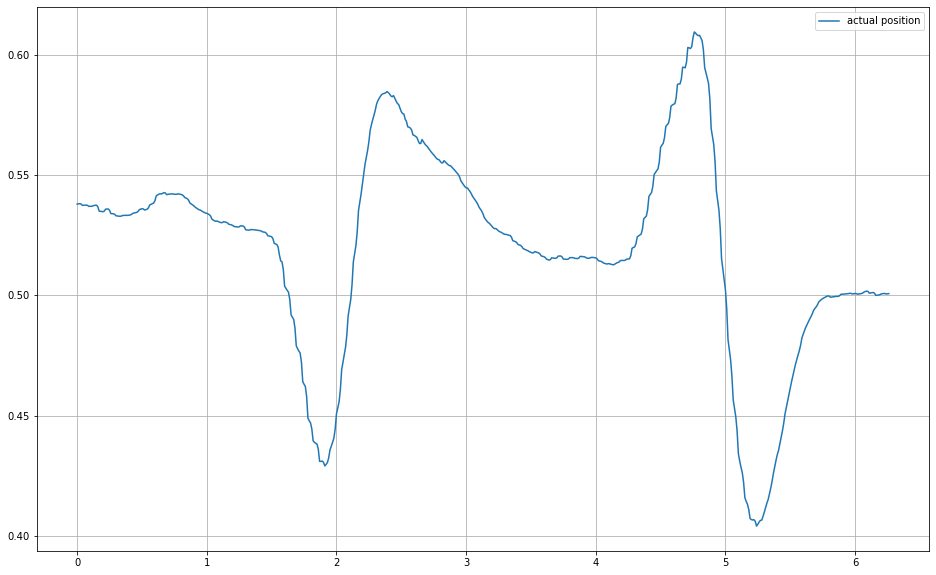

In [6]:
plt.figure(figsize=(16, 10))
plt.plot(t, o_z_default, label='actual position')
print((max(o_z_default)+min(o_z_default))/2)
#plt.plot(t, o_z_des, label='desired position')
plt.legend()
plt.grid()

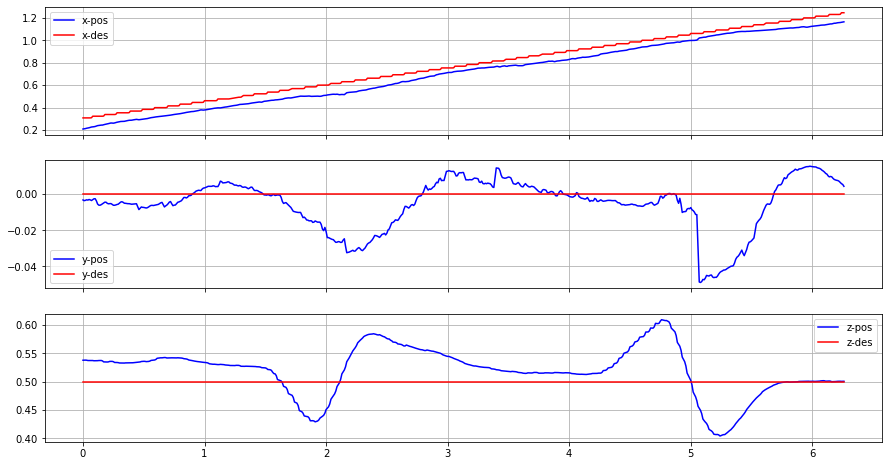

In [7]:
fig, (xt, yt, zt) = plt.subplots(3, 1, figsize=(15, 8), sharex=True)

#px = xt.plot(t, o_x_custom, label=f'o_x (custom observer)')
xt.plot(t, o_x_default, color = 'b', label='x-pos')
xt.plot(t, o_x_des, color = 'r', label = 'x-des')
xt.legend()
xt.grid()

yt.plot(t, o_y_default, color = 'b', label='y-pos')
yt.plot(t, o_y_des, color = 'r', label = 'y-des')
yt.legend()
yt.grid()

zt.plot(t, o_z_default, color='b', label='z-pos')
zt.plot(t, o_z_des, color = 'r', label = 'z-des')
zt.legend()
zt.grid()

In [8]:
df = pd.DataFrame(list(zip(np.array(o_x_default), np.array(o_y_default), np.array(o_z_default))), 
             columns =['custom x', 'custom y', 'custom z'],
             index = range(1,len(o_x_default)+1))

df

,custom x,custom y,custom z
1,0.208784,-0.003282,0.538001
2,0.210362,-0.003678,0.538093
3,0.212486,-0.003477,0.538196
4,0.215670,-0.003204,0.538034
5,0.217534,-0.003358,0.537491
...,...,...,...
623,1.157562,0.007051,0.500791
624,1.158639,0.006374,0.500781
625,1.160376,0.005694,0.500599
626,1.161893,0.005288,0.500679


In [9]:
fig = px.line_3d(df, x='custom x', y='custom y', z='custom z', width=800, height=600)
fig.show()

# Flying over an empty grid with stock Cont & Obs

In [10]:
def rmse(x, y):
    return np.sqrt(np.mean((x - y)**2))

In [11]:
# flight test data
data = load_hardware_data('empty_grid_def_data.json', only_in_flight=True)

data1 = load_hardware_data(
    'empty_grid_def_data.json',   # <-- FIXME: replace with name of file with data
    t_min_offset=0.,
    t_max_offset=40.,
    only_in_flight=True,
)

data2 = load_hardware_data(
    'empty_grid_def_data.json',   # <-- FIXME: replace with name of file with data
    t_min_offset=45.,
    t_max_offset=0.,
    only_in_flight=True,
)

# times
t = data['time']

# position and orientation from default observer
o_x_default_1 = data1['stateEstimate.x']
o_y_default_1 = data1['stateEstimate.y']
o_z_default_1 = data1['stateEstimate.z']

# # position and orientation from custom observer
# o_x_custom = data['ae483log.o_x']
# o_y_custom = data['ae483log.o_y']

# # desired position
o_x_des_1 = data1['ctrltarget.x']
o_y_des_1 = data1['ctrltarget.y']
o_z_des_1 = data1['ctrltarget.z']

# position and orientation from default observer
o_x_default_2 = data2['stateEstimate.x']
o_y_default_2 = data2['stateEstimate.y']
o_z_default_2 = data2['stateEstimate.z']

# # position and orientation from custom observer
# o_x_custom1 = data1['ae483log.o_x']
# o_y_custom1 = data1['ae483log.o_y']

# # desired position
o_x_des_2 = data2['ctrltarget.x']
o_y_des_2 = data2['ctrltarget.y']
o_z_des_2 = data2['ctrltarget.z']

# position and orientation from default observer
o_x_default = data['stateEstimate.x']
o_y_default = data['stateEstimate.y']
o_z_default = data['stateEstimate.z']

# # position and orientation from custom observer
# o_x_custom2 = data2['ae483log.o_x']
# o_y_custom2 = data2['ae483log.o_y']

# # desired position
o_x_des = data['ctrltarget.x']
o_y_des = data['ctrltarget.y']
o_z_des = data['ctrltarget.z']



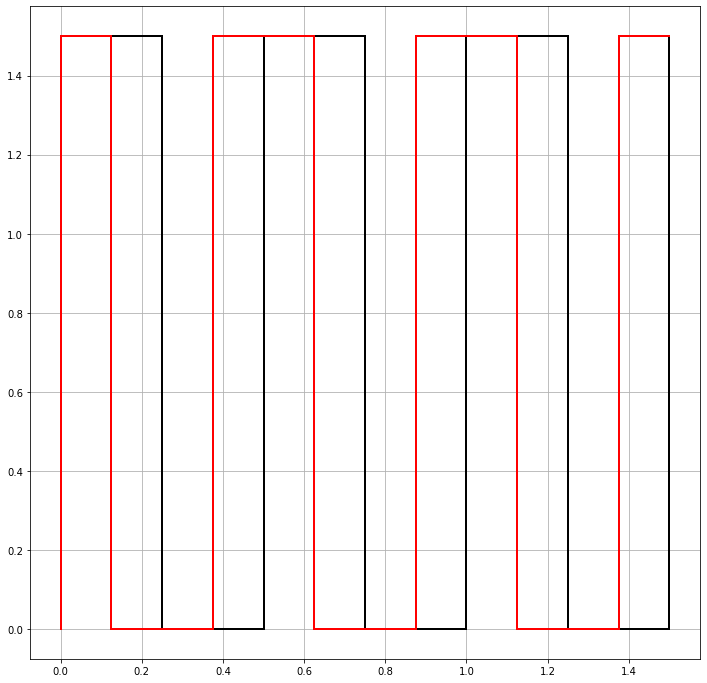

In [12]:
x_vals = []
y_vals = []
myval = 414

plt.figure(figsize=(12,12))

step = 0.25
val = 0

for i in range(0,7):
    if i%2 == 0:
        y1 = np.linspace(0, 1.5, myval)
        x1 = np.full(len(y1), val)
        x2 = np.linspace(val, step, myval)
        y2 = np.full(len(x2), 1.5)
    else:
        y1 = np.linspace(1.5, 0, myval)
        x1 = np.full(len(y1), val)
        x2 = np.linspace(val, step, myval)
        y2 = np.full(len(x2), 0)
    
    x_vals.append(x1.tolist())
    y_vals.append(y1.tolist())
    plt.plot(x1,y1, linewidth=2, color='k')
    if i < 6:
        x_vals.append(x2.tolist())
        y_vals.append(y2.tolist())
        plt.plot(x2,y2, linewidth=2, color='k')
    step = step + 0.25
    val = val + 0.25

val1 = 1.375
val2 = 1.125

for i in range(0,7):
    if i%2 == 0:
        if i == 0:
            y1 = np.linspace(1.5, 0, myval)
            x1 = np.full(len(y1), 1.5-0.125)
            x2 = np.linspace(1.5, 1.5-0.125, myval)
            y2 = np.full(len(x2), 1.5)
        elif i == 6:
            y1 = np.linspace(1.5, 0, myval)
            x1 = np.full(len(y1), 0)
            x2 = np.linspace(0.125, 0, myval)
            y2 = np.full(len(x2), 1.5)
        else:
            y1 = np.linspace(1.5, 0, myval)
            x1 = np.full(len(y1), val1)
            x2 = np.linspace(val1 + 0.25 , val1, myval)
            y2 = np.full(len(x2), 1.5)
    else:
        y1 = np.linspace(0, 1.5, myval)
        x1 = np.full(len(y1), val2)
        x2 = np.linspace(val2 + 0.25 , val2, myval)
        y2 = np.full(len(x2), 0)
        val2 = val2 - 0.5
    
    plt.plot(x1,y1, linewidth=2, color='r')
    plt.plot(x2,y2, linewidth=2, color='r')
    x_vals.append(x1.tolist())
    y_vals.append(y1.tolist())
    val1 = val1 - 0.25
    
x_flat = list(np.concatenate(x_vals).flat)
y_flat = list(np.concatenate(y_vals).flat)
    
plt.grid()

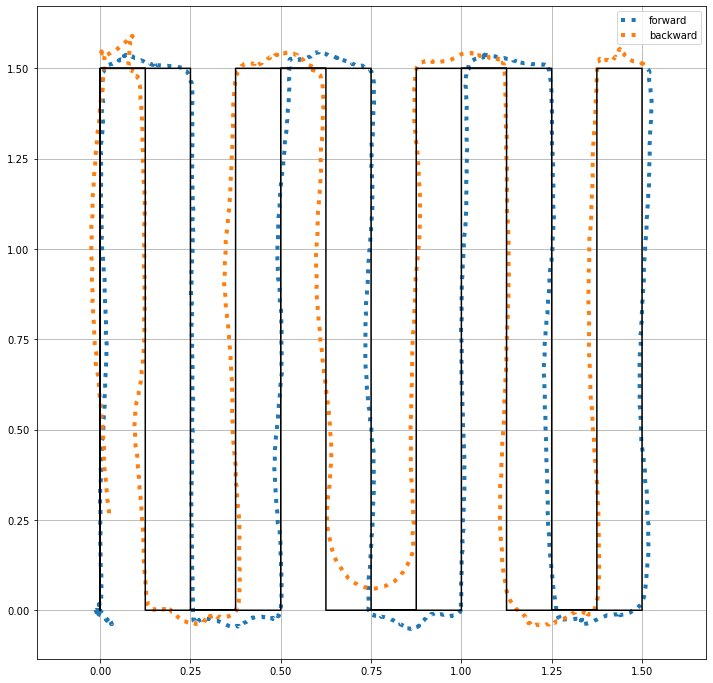

In [13]:
plt.figure(figsize=(12,12))
plt.plot(o_x_default_1, o_y_default_1, ':', label='forward', linewidth=4)
plt.plot(o_x_default_2, o_y_default_2, ':', label='backward', linewidth=4)
plt.plot(x_flat,y_flat, color = 'k')
plt.axis('equal')
plt.legend()
plt.grid()

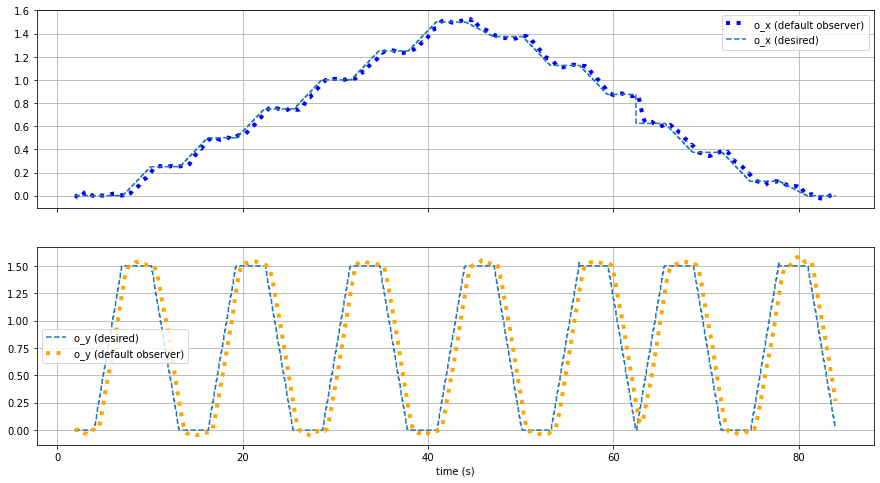

In [14]:
fig, (ax_pos, ax_ori) = plt.subplots(2, 1, figsize=(15, 8), sharex=True)

ax_pos.plot(t, o_x_default, ':', label=f'o_x (default observer)', color='b', linewidth=4)

ax_pos.plot(t, o_x_des, '--', label=f'o_x (desired)')
ax_ori.plot(t, o_y_des, '--', label=f'o_y (desired)')

ax_pos.legend()
ax_pos.grid()
ax_ori.plot(t, o_y_default, ':', label=f'o_y (default observer)', color='orange', linewidth=4)
ax_ori.grid()
ax_ori.legend()
ax_ori.set_xlabel('time (s)')
plt.show()

In [15]:
flag = np.full(len(o_z_default), 0)
df_path = pd.DataFrame(list(zip(o_x_default, o_y_default, o_z_default, flag)), 
             columns =['x', 'y', 'z', 'flag'])


flag = np.full(len(o_z_default), 1)
df_eg = pd.DataFrame(list(zip(o_x_des,o_y_des,o_z_des,flag)), 
             columns =['x', 'y', 'z', 'flag'])



In [16]:
frames = [df_eg, df_path]
result = pd.concat(frames)

fig = px.line_3d(result, x="x",
                 y="y", 
                 z="z", 
                 color="flag")
fig.show()

In [17]:
print(f'RMSE from t={t[0]} to t={t[-1]} (with targets shown at right):')
print(f' o_x:   {rmse(o_x_default, o_x_des):7.3f}  / {0.075:7.3f}')
print(f' o_y:   {rmse(o_y_default, o_y_des):7.3f}  / {0.075:7.3f}')
print(f' o_z:   {rmse(o_z_default, o_z_des):7.3f}  / {0.075:7.3f}')
print(f' psi:   {rmse(psi_default, 0.):7.3f}  / {0.05:7.3f}')
print(f' theta: {rmse(theta_default, 0.):7.3f}  / {0.015:7.3f}')
print(f' phi:   {rmse(phi_default, 0.):7.3f}  / {0.015:7.3f}')

RMSE from t=1.87 to t=83.96 (with targets shown at right):
 o_x:     0.034  /   0.075
 o_y:     0.190  /   0.075
 o_z:     0.016  /   0.075
 psi:     0.011  /   0.050
 theta:   0.014  /   0.015
 phi:     0.014  /   0.015


In [18]:
fig = go.Figure(data=[go.Mesh3d(x=o_x_default,
                   y=o_y_default,
                   z=o_z_default,
                   opacity=1,
                   intensity=o_z_default,
                   colorscale='Viridis',
                   contour_width=2, contour_color="#101010", contour_show=True,
                  )])

fig.update_traces(lighting=dict(ambient=0.8, diffuse=0.5, 
                                specular=0.5, roughness=0.5, 
                                fresnel=0.5))

# fig.update_traces(contour=dict(show=True, usecolormap=True,
#                                   highlightcolor="limegreen", project_z=True))

# fig.update_layout(title='Mt Bruno Elevation', autosize=False,
#                   scene_camera_eye=dict(x=1.87, y=0.88, z=-0.64),
#                   width=500, height=500,
#                   margin=dict(l=65, r=50, b=65, t=90)
# )

fig.show()

# Flying over an Empty Grid with Custom Cont & Obs

In [19]:
# flight test data
data = load_hardware_data('empty_grid_custom_data.json', only_in_flight=True)

data1 = load_hardware_data(
    'empty_grid_custom_data.json',   # <-- FIXME: replace with name of file with data
    t_min_offset=0.,
    t_max_offset=40.,
    only_in_flight=True,
)

data2 = load_hardware_data(
    'empty_grid_custom_data.json',   # <-- FIXME: replace with name of file with data
    t_min_offset=45.,
    t_max_offset=0.,
    only_in_flight=True,
)

# times
t = data['time']

# position and orientation from default observer
o_x_default = data['stateEstimate.x']
o_y_default = data['stateEstimate.y']
o_z_default = data['stateEstimate.z']

# position and orientation from custom observer
o_x_custom = data['ae483log.o_x']
o_y_custom = data['ae483log.o_y']

# desired position
o_x_des = data['ae483log.o_x_des']
o_y_des = data['ae483log.o_y_des']
o_z_des = data['ae483log.o_z_des']

# position and orientation from default observer
o_x_default1 = data1['stateEstimate.x']
o_y_default1 = data1['stateEstimate.y']

# position and orientation from custom observer
o_x_custom1 = data1['ae483log.o_x']
o_y_custom1 = data1['ae483log.o_y']

# desired position
o_x_des1 = data1['ae483log.o_x_des']
o_y_des1 = data1['ae483log.o_y_des']
o_z_des1 = data1['ae483log.o_z_des']

# position and orientation from default observer
o_x_default2 = data2['stateEstimate.x']
o_y_default2 = data2['stateEstimate.y']

# position and orientation from custom observer
o_x_custom2 = data2['ae483log.o_x']
o_y_custom2 = data2['ae483log.o_y']

# desired position
o_x_des2 = data2['ae483log.o_x_des']
o_y_des2 = data2['ae483log.o_y_des']
o_z_des2 = data2['ae483log.o_z_des']

FileNotFoundError: [Errno 2] No such file or directory: 'empty_grid_custom_data.json'

In [ ]:
x_vals = []
y_vals = []
myval = 414

plt.figure(figsize=(12,12))

step = 0.25
val = 0

for i in range(0,7):
    if i%2 == 0:
        y1 = np.linspace(0, 1.5, myval)
        x1 = np.full(len(y1), val)
        x2 = np.linspace(val, step, myval)
        y2 = np.full(len(x2), 1.5)
    else:
        y1 = np.linspace(1.5, 0, myval)
        x1 = np.full(len(y1), val)
        x2 = np.linspace(val, step, myval)
        y2 = np.full(len(x2), 0)
    
    x_vals.append(x1.tolist())
    y_vals.append(y1.tolist())
    plt.plot(x1,y1, linewidth=2, color='k')
    if i < 6:
        x_vals.append(x2.tolist())
        y_vals.append(y2.tolist())
        plt.plot(x2,y2, linewidth=2, color='k')
    step = step + 0.25
    val = val + 0.25

val1 = 1.375
val2 = 1.125

for i in range(0,7):
    if i%2 == 0:
        if i == 0:
            y1 = np.linspace(1.5, 0, myval)
            x1 = np.full(len(y1), 1.5-0.125)
            x2 = np.linspace(1.5, 1.5-0.125, myval)
            y2 = np.full(len(x2), 1.5)
        elif i == 6:
            y1 = np.linspace(1.5, 0, myval)
            x1 = np.full(len(y1), 0)
            x2 = np.linspace(0.125, 0, myval)
            y2 = np.full(len(x2), 1.5)
        else:
            y1 = np.linspace(1.5, 0, myval)
            x1 = np.full(len(y1), val1)
            x2 = np.linspace(val1 + 0.25 , val1, myval)
            y2 = np.full(len(x2), 1.5)
    else:
        y1 = np.linspace(0, 1.5, myval)
        x1 = np.full(len(y1), val2)
        x2 = np.linspace(val2 + 0.25 , val2, myval)
        y2 = np.full(len(x2), 0)
        val2 = val2 - 0.5
    
    plt.plot(x1,y1, linewidth=2, color='r')
    plt.plot(x2,y2, linewidth=2, color='r')
    x_vals.append(x1.tolist())
    y_vals.append(y1.tolist())
    val1 = val1 - 0.25
    
x_flat = list(np.concatenate(x_vals).flat)
y_flat = list(np.concatenate(y_vals).flat)
    
plt.grid()

In [20]:
plt.figure(figsize=(12,12))
plt.plot(o_x_default1, o_y_default1, ':', label='forward', linewidth=4)
plt.plot(o_x_default2, o_y_default2, ':', label='backward', linewidth=4)
plt.plot(x_flat,y_flat, color = 'k')
plt.axis('equal')
plt.legend()
plt.grid()

NameError: name 'o_x_default1' is not defined

<Figure size 864x864 with 0 Axes>

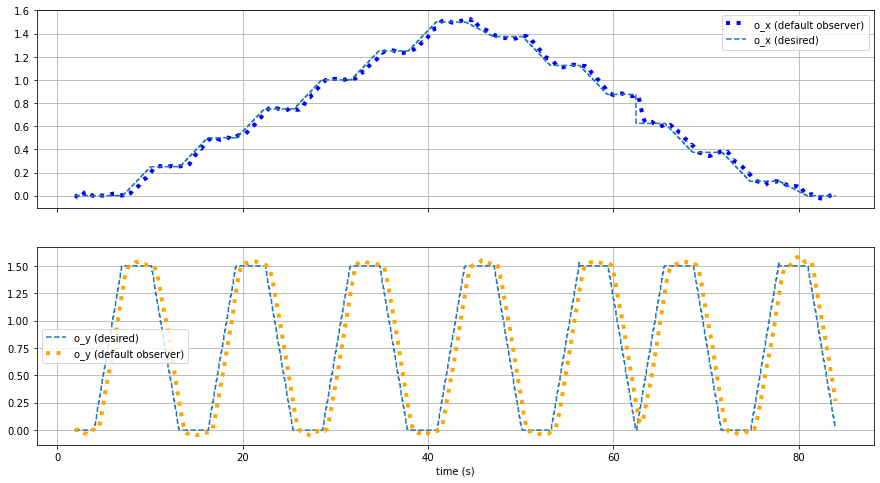

In [21]:
fig, (ax_pos, ax_ori) = plt.subplots(2, 1, figsize=(15, 8), sharex=True)

ax_pos.plot(t, o_x_default, ':', label=f'o_x (default observer)', color='b', linewidth=4)

ax_pos.plot(t, o_x_des, '--', label=f'o_x (desired)')
ax_ori.plot(t, o_y_des, '--', label=f'o_y (desired)')

ax_pos.legend()
ax_pos.grid()
ax_ori.plot(t, o_y_default, ':', label=f'o_y (default observer)', color='orange', linewidth=4)
ax_ori.grid()
ax_ori.legend()
ax_ori.set_xlabel('time (s)')
plt.show()

In [22]:
flag = np.full(len(o_z_default), 0)
df_path = pd.DataFrame(list(zip(o_x_default, o_y_default, o_z_default, flag)), 
             columns =['x', 'y', 'z', 'flag'])


flag = np.full(len(o_z_default), 1)
df_eg = pd.DataFrame(list(zip(o_x_des,o_y_des,o_z_des,flag)), 
             columns =['x', 'y', 'z', 'flag'])



In [23]:
frames = [df_eg, df_path]
result = pd.concat(frames)

fig = px.line_3d(result, x="x",
                 y="y", 
                 z="z", 
                 color="flag")
fig.show()

In [114]:
print(f'RMSE from t={t[0]} to t={t[-1]} (with targets shown at right):')
print(f' o_x:   {rmse(o_x_default, o_x_des):7.3f}  / {0.075:7.3f}')
print(f' o_y:   {rmse(o_y_default, o_y_des):7.3f}  / {0.075:7.3f}')
print(f' o_z:   {rmse(o_z_default, o_z_des):7.3f}  / {0.075:7.3f}')
print(f' psi:   {rmse(psi_default, 0.):7.3f}  / {0.05:7.3f}')
print(f' theta: {rmse(theta_default, 0.):7.3f}  / {0.015:7.3f}')
print(f' phi:   {rmse(phi_default, 0.):7.3f}  / {0.015:7.3f}')

RMSE from t=1.87 to t=84.04 (with targets shown at right):
 o_x:     0.056  /   0.075
 o_y:     0.296  /   0.075
 o_z:     0.059  /   0.075
 psi:     0.011  /   0.050
 theta:   0.014  /   0.015
 phi:     0.014  /   0.015


In [115]:
fig = go.Figure(data=[go.Mesh3d(x=o_x_default,
                   y=o_y_default,
                   z=o_z_default,
                   opacity=1,
                   intensity=o_z_default,
                   colorscale='Viridis',
                   contour_width=2, contour_color="#101010", contour_show=True,
                  )])

fig.update_traces(lighting=dict(ambient=0.8, diffuse=0.5, 
                                specular=0.5, roughness=0.5, 
                                fresnel=0.5))

# fig.update_traces(contour=dict(show=True, usecolormap=True,
#                                   highlightcolor="limegreen", project_z=True))

# fig.update_layout(title='Mt Bruno Elevation', autosize=False,
#                   scene_camera_eye=dict(x=1.87, y=0.88, z=-0.64),
#                   width=500, height=500,
#                   margin=dict(l=65, r=50, b=65, t=90)
# )

fig.show()

# Flying over a Grid with stock Cont & Obs

In [24]:
# flight test data
data = load_hardware_data('grid_def_5_data.json', only_in_flight=True)

data1 = load_hardware_data(
    'grid_def_5_data.json',   # <-- FIXME: replace with name of file with data
    t_min_offset=0.,
    t_max_offset=53.,
    only_in_flight=True,
)

data2 = load_hardware_data(
    'grid_def_5_data.json',   # <-- FIXME: replace with name of file with data
    t_min_offset=58.,
    t_max_offset=0.,
    only_in_flight=True,
)



# times
t = data['time']




# position and orientation from default observer
o_x_default_1 = data1['stateEstimate.x']
o_y_default_1 = data1['stateEstimate.y']
o_z_default_1 = data1['stateEstimate.z']

# # position and orientation from custom observer
# o_x_custom = data['ae483log.o_x']
# o_y_custom = data['ae483log.o_y']

# # desired position
o_x_des_1 = data1['ctrltarget.x']
o_y_des_1 = data1['ctrltarget.y']
o_z_des_1 = data1['ctrltarget.z']

# position and orientation from default observer
o_x_default_2 = data2['stateEstimate.x']
o_y_default_2 = data2['stateEstimate.y']
o_z_default_2 = data2['stateEstimate.z']

# # position and orientation from custom observer
# o_x_custom1 = data1['ae483log.o_x']
# o_y_custom1 = data1['ae483log.o_y']

# # desired position
o_x_des_2 = data2['ctrltarget.x']
o_y_des_2 = data2['ctrltarget.y']
o_z_des_2 = data2['ctrltarget.z']

# position and orientation from default observer
o_x_default = data['stateEstimate.x']
o_y_default = data['stateEstimate.y']
o_z_default = data['stateEstimate.z']

# # position and orientation from custom observer
# o_x_custom2 = data2['ae483log.o_x']
# o_y_custom2 = data2['ae483log.o_y']

# # desired position
o_x_des = data['ctrltarget.x']
o_y_des = data['ctrltarget.y']
o_z_des = data['ctrltarget.z']


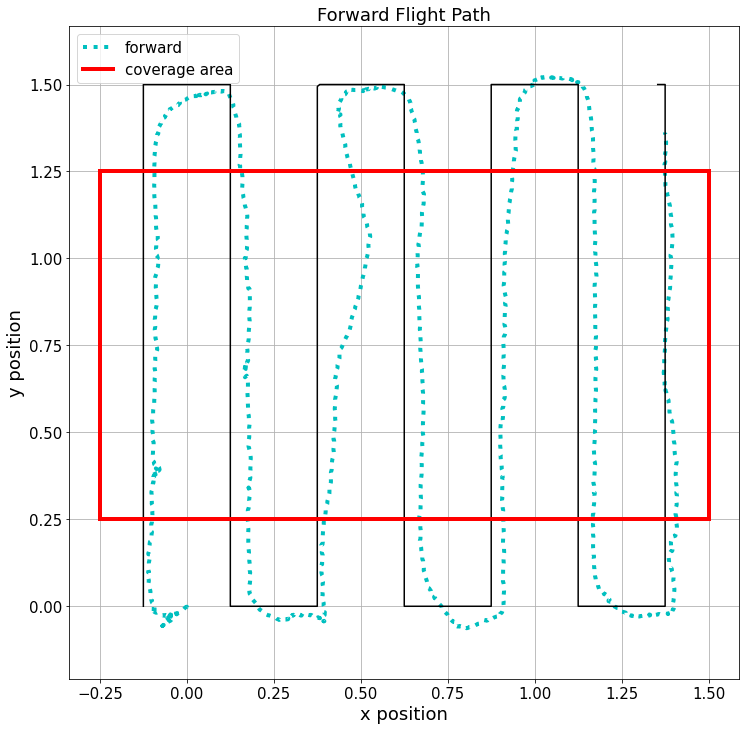

In [31]:
xss = np.linspace(-0.25,1.5,100)
y_center = np.full(len(xss), 1.25)
y_cen = np.full(len(xss), 0.25)

ys = np.linspace(0.25,1.25,100)
x_center = np.full(len(ys),-0.25)
x_cen = np.full(len(ys), 1.50)


plt.figure(figsize=(12,12))
plt.plot(o_x_default_1, o_y_default_1, ':', label='forward', linewidth=4, color = 'c')
#plt.plot(o_x_default_2, o_y_default_2, ':', label='backward', linewidth=4)
plt.plot(o_x_des_1-0.125, o_y_des_1, color = 'k')
plt.plot(xss,y_center, color = 'r', linewidth = 4)
plt.plot(xss, y_cen, color = 'r', linewidth = 4)
plt.plot(x_center, ys, color = 'r', linewidth = 4, label = 'coverage area')
plt.plot(x_cen, ys, color = 'r', linewidth = 4)
plt.title('Forward Flight Path', fontsize = 18)
plt.axis('equal')
plt.xticks(fontsize = 15)
plt.yticks(fontsize = 15)
plt.xlabel('x position', fontsize = 18)
plt.ylabel('y position', fontsize = 18)
plt.legend(prop={"size":15})
plt.grid()
plt.savefig('2dflightpath_forw.jpg', dpi = 300)

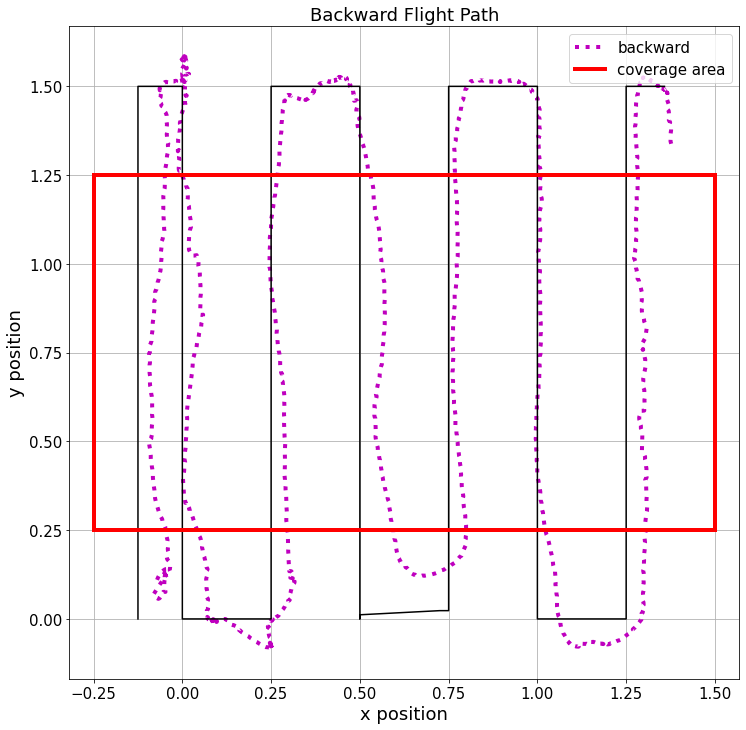

In [36]:
xss = np.linspace(-0.25,1.5,100)
y_center = np.full(len(xss), 1.25)
y_cen = np.full(len(xss), 0.25)

ys = np.linspace(0.25,1.25,100)
x_center = np.full(len(ys),-0.25)
x_cen = np.full(len(ys), 1.50)



plt.figure(figsize=(12,12))
#plt.plot(o_x_default_1, o_y_default_1, ':', label='forward', linewidth=4)
plt.plot(o_x_default_2, o_y_default_2, ':', label='backward', linewidth=4, color = 'm')
plt.plot(o_x_des_2-0.125, o_y_des_2, color = 'k')
plt.plot(xss,y_center, color = 'r', linewidth = 4, label = 'coverage area')
plt.plot(xss, y_cen, color = 'r', linewidth = 4)
plt.plot(x_center, ys, color = 'r', linewidth = 4)
plt.plot(x_cen, ys, color = 'r', linewidth = 4)
plt.title('Backward Flight Path', fontsize = 18)
plt.xlabel('x position', fontsize = 18)
plt.ylabel('y position', fontsize = 18)
plt.xticks(fontsize = 15)
plt.yticks(fontsize = 15)
plt.axis('equal')
plt.legend(loc='upper right',prop={"size":15})
plt.grid()
plt.savefig('2dflightpath_back.jpg', dpi=300)

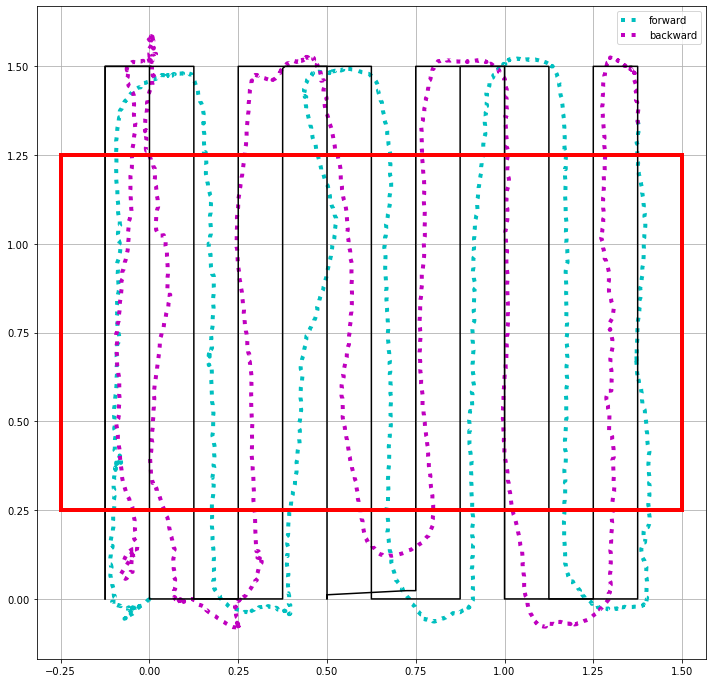

In [402]:
xss = np.linspace(-0.25,1.5,100)
y_center = np.full(len(xss), 1.25)
y_cen = np.full(len(xss), 0.25)

ys = np.linspace(0.25,1.25,100)
x_center = np.full(len(ys),-0.25)
x_cen = np.full(len(ys), 1.50)


plt.figure(figsize=(12,12))
plt.plot(o_x_default_1, o_y_default_1, ':', label='forward', linewidth=4, color = 'c')
plt.plot(o_x_default_2, o_y_default_2, ':', label='backward', linewidth=4, color = 'm')
plt.plot(o_x_des_1-0.125, o_y_des_1, color = 'k')
plt.plot(o_x_des_2-0.125, o_y_des_2, color = 'k')
plt.plot(xss,y_center, color = 'r', linewidth = 4)
plt.plot(xss, y_cen, color = 'r', linewidth = 4)
plt.plot(x_center, ys, color = 'r', linewidth = 4)
plt.plot(x_cen, ys, color = 'r', linewidth = 4)
plt.axis('equal')
plt.legend()
plt.grid()
plt.savefig('2dflightpath_2.png')

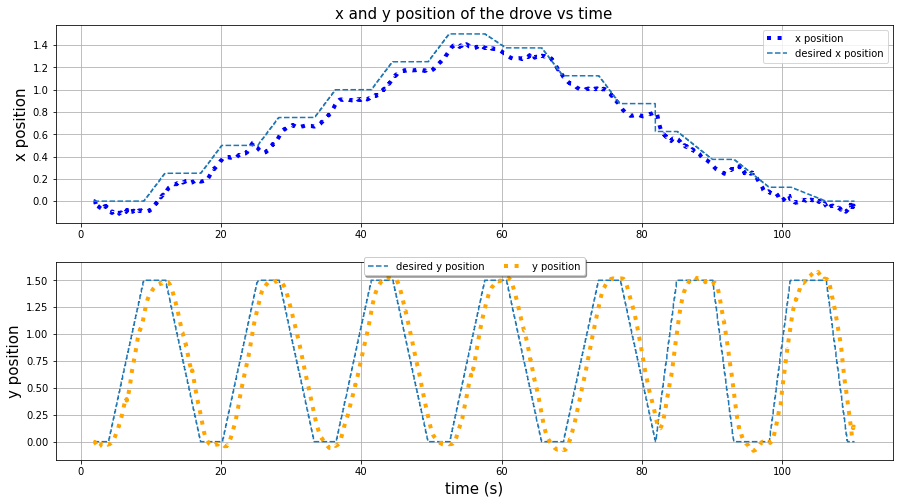

In [403]:
fig, (ax_pos, ax_ori) = plt.subplots(2, 1, figsize=(15, 8), sharex=False)

ax_pos.plot(t, o_x_default, ':', label=f'x position', color='b', linewidth=4)

ax_pos.plot(t, o_x_des, '--', label=f'desired x position')
ax_ori.plot(t, o_y_des, '--', label=f'desired y position')

ax_pos.legend()
ax_pos.grid()
ax_ori.plot(t, o_y_default, ':', label=f'y position', color='orange', linewidth=4)
ax_ori.grid()
ax_ori.legend(loc='upper center', bbox_to_anchor=(0.5, 1.05),
          ncol=3, fancybox=True, shadow=True, prop={"size":10})
ax_pos.legend(prop={"size":10})
ax_pos.set_ylabel('x position', fontsize = 15)
ax_ori.set_ylabel('y position', fontsize = 15)
ax_ori.set_xlabel('time (s)', fontsize = 15)

ax_pos.set_title('x and y position of the drove vs time', fontsize = 15)
plt.savefig('positionsVStime.jpg', dpi = 300)
plt.show()

0.1831313995122909


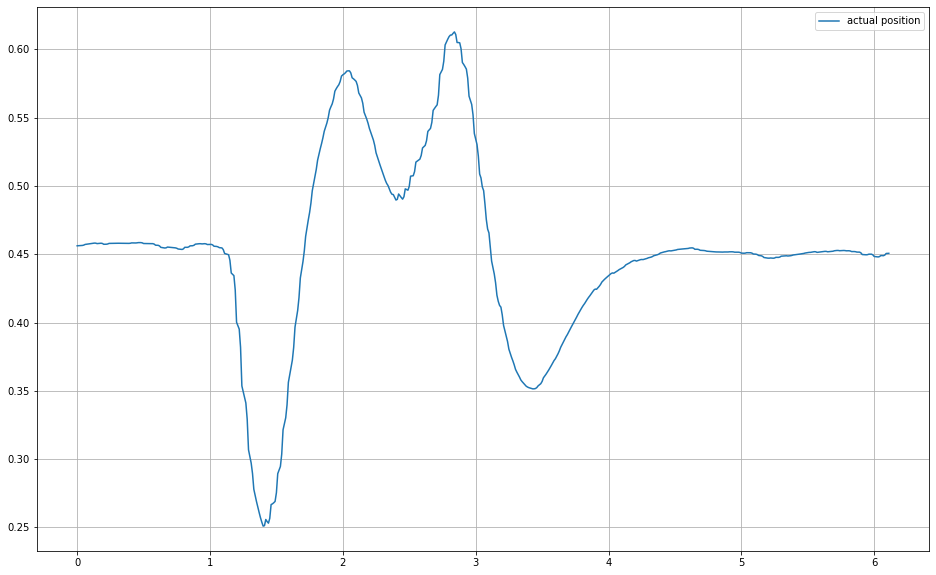

In [404]:
data3 = load_hardware_data(
    'grid_def_5_data.json',   # <-- FIXME: replace with name of file with data
    t_min_offset=5.,
    t_max_offset=100.,
    only_in_flight=True,
)

t = data3['time']

# position and orientation from default observer
o_x_default_3 = data3['stateEstimate.x']
o_y_default_3 = data3['stateEstimate.y']
o_z_default_3 = data3['stateEstimate.z']

index_1 = np.where(t == 1.0)
index_2 = np.where(t == 4.5)
index_3 = np.where(t == 5)

hover_h1 = np.mean(o_z_default_3[0:index[0][0]])
hover_h2 = np.mean(o_z_default_3[index_2[0][0]:index_3[0][0]])

object_h1 = hover_h-min(o_z_default_3)
object_h2 = max(o_z_default_3)-hover_h2



height = (object_h2+object_h1)/2

print(height)

plt.figure(figsize=(16, 10))
plt.plot(t, o_z_default_3, label='actual position')
#plt.plot(t, o_z_des, label='desired position')
plt.legend()
plt.grid()

0.17329503403604027


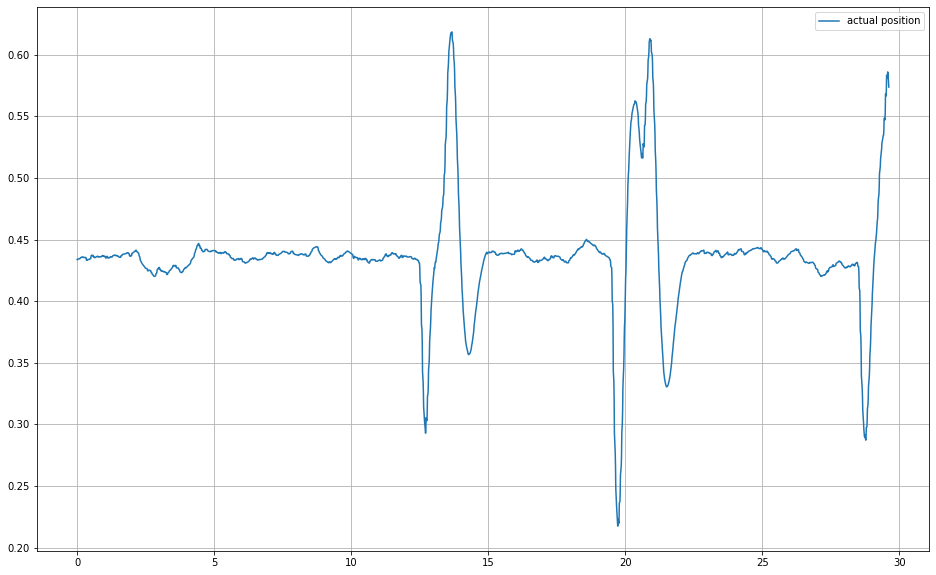

In [393]:
data4 = load_hardware_data(
    'grid_def_5_data.json',   # <-- FIXME: replace with name of file with data
    t_min_offset=80.,
    t_max_offset=1.5,
    only_in_flight=True,
)

t = data4['time']

# position and orientation from default observer
o_x_default_3 = data4['stateEstimate.x']
o_y_default_3 = data4['stateEstimate.y']
o_z_default_3 = data4['stateEstimate.z']



index1 = np.where(t == 10)
index2 = np.where(t == 15)
index3 = np.where(t == 25)
index4 = np.where(t == 18)
index5 = np.where(t == 21)
index6 = np.where(t == 27)

z_1 = o_z_default_3[index1[0][0]:index2[0][0]]
z_2 = o_z_default_3[index2[0][0]:index3[0][0]]
z_3 = o_z_default_3[index3[0][0]:]

hover1 = np.mean(o_z_default_3[0:index1[0][0]])
hover2 = np.mean(o_z_default_3[index2[0][0]:index4[0][0]])
hover3 = np.mean(o_z_default_3[index5[0][0]:index6[0][0]])

object1 = hover1-min(z_1)
object2 = max(z_1)-hover1
object3 = hover2-min(z_2)
object4 = max(z_2)-hover2
object5 = hover3-min(z_3)
object6 = max(z_3)-hover3



height = (object_h2+object_h1+object1+object2+object3+object4+object5+object6)/8

print(height)

plt.figure(figsize=(16, 10))
plt.plot(t, o_z_default_3, label='actual position')
#plt.plot(t, o_z_des, label='desired position')
plt.legend()
plt.grid()

In [394]:
flag = np.full(len(o_z_default), 0)
df_path = pd.DataFrame(list(zip(o_x_default, o_y_default, o_z_default, flag)), 
             columns =['x', 'y', 'z', 'flag'])


flag = np.full(len(o_z_default), 1)
df_eg = pd.DataFrame(list(zip(o_x_des,o_y_des,o_z_des,flag)), 
             columns =['x', 'y', 'z', 'flag'])



In [395]:
frames = [df_eg, df_path]
result = pd.concat(frames)

fig = px.line_3d(result, x="x",
                 y="y", 
                 z="z", 
                 color="flag")
fig.show()

In [396]:
print(f'RMSE from t={t[0]} to t={t[-1]} (with targets shown at right):')
print(f' o_x:   {rmse(o_x_default, o_x_des):7.3f}  / {0.075:7.3f}')
print(f' o_y:   {rmse(o_y_default, o_y_des):7.3f}  / {0.075:7.3f}')
print(f' o_z:   {rmse(o_z_default, o_z_des):7.3f}  / {0.075:7.3f}')
print(f' psi:   {rmse(psi_default, 0.):7.3f}  / {0.05:7.3f}')
print(f' theta: {rmse(theta_default, 0.):7.3f}  / {0.015:7.3f}')
print(f' phi:   {rmse(phi_default, 0.):7.3f}  / {0.015:7.3f}')

RMSE from t=0.0 to t=29.61 (with targets shown at right):
 o_x:     0.095  /   0.075
 o_y:     0.229  /   0.075
 o_z:     0.078  /   0.075
 psi:     0.011  /   0.050
 theta:   0.014  /   0.015
 phi:     0.014  /   0.015


In [438]:
o_z_default = o_z_default-0.45
o_z_default = np.where(o_z_default < 0, 0, o_z_default)

fig = go.Figure(data=[go.Mesh3d(x=o_x_default,
                   y=o_y_default,
                   z=o_z_default,
                   opacity=1,
                   intensity=o_z_default,
                   colorscale='Viridis',
                   contour_width=2, contour_color="#101010", contour_show=True,
                  )])

fig.update_traces(lighting=dict(ambient=0.8, diffuse=0.5, 
                                specular=0.5, roughness=0.5, 
                                fresnel=0.5))

# fig.update_traces(contour=dict(show=True, usecolormap=True,
#                                   highlightcolor="limegreen", project_z=True))

fig.update_layout(title = 'Topographical Visualization of the Location the Drone Flew Over' , autosize=True,
                  scene_camera_eye=dict(x=-1.1, y=-1.4, z=1.3),
                  
                  
)

fig.show()

In [299]:
x_re = o_x_default[::20]
y_re = o_y_default[::20]
z_re = o_z_default[::20]

In [176]:
lat_vals, lat_idx = np.unique(x_re, return_inverse=True)
lon_vals, lon_idx = np.unique(y_re, return_inverse=True)
vals_array = np.empty(lat_vals.shape + lon_vals.shape)
vals_array.fill(0.45) # or whatever yor desired missing data flag is

vals_array[lat_idx, lon_idx] = z_re
vals_array

array([[0.45, 0.45, 0.45, ..., 0.45, 0.45, 0.45],
       [0.45, 0.45, 0.45, ..., 0.45, 0.45, 0.45],
       [0.45, 0.45, 0.45, ..., 0.45, 0.45, 0.45],
       ...,
       [0.45, 0.45, 0.45, ..., 0.45, 0.45, 0.45],
       [0.45, 0.45, 0.45, ..., 0.45, 0.45, 0.45],
       [0.45, 0.45, 0.45, ..., 0.45, 0.45, 0.45]])

In [177]:
fig = go.Figure(data=[go.Surface(z=vals_array)])
fig.update_traces(contours_z=dict(show=True, usecolormap=True,
                                  highlightcolor="limegreen", project_z=True))
fig.update_layout(title='Mt Bruno Elevation', autosize=False,
                  scene_camera_eye=dict(x=1.87, y=0.88, z=-0.64),
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90)
)

fig.show()